In [158]:
import pandas as pd
data = pd.read_csv("train.csv")

print("Success!")


data.head()

Success!


,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [110]:
import numpy as np # linear algebra
import seaborn as sns
import matplotlib as plt
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from sklearn.decomposition import PCA, RandomizedPCA
from sklearn.manifold import TSNE

sns.set_style("darkgrid", {"axes.facecolor": ".95"})
%config InlineBackend.figure_format = 'svg'

In [159]:
X = data.loc[:,"pixel0":"pixel783"]
y = data.label
print("ready")


print(y)


ready
0        1
1        0
2        1
3        4
4        0
5        0
6        7
7        3
8        5
9        3
10       8
11       9
12       1
13       3
14       3
15       1
16       2
17       0
18       7
19       5
20       8
21       6
22       2
23       0
24       2
25       3
26       6
27       9
28       9
29       7
        ..
41970    2
41971    3
41972    4
41973    4
41974    3
41975    9
41976    2
41977    4
41978    4
41979    4
41980    7
41981    2
41982    8
41983    7
41984    3
41985    3
41986    0
41987    5
41988    0
41989    5
41990    3
41991    1
41992    9
41993    6
41994    4
41995    0
41996    1
41997    7
41998    6
41999    9
Name: label, Length: 42000, dtype: int64


In [125]:
print(X.shape, y.shape)

(42000, 784) (42000,)


In [138]:

feat_cols = ['pixel'+str(i) for i in range(X.shape[1]) ]
data.head()


,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,label
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,None
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,None
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,None
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,None
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,None


In [150]:
from sklearn.decomposition import PCA

def run_pca(data, dimensions):
  pca = PCA(n_components=dimensions)
  pca.fit(data)
  pca_results = pca.transform(data[feat_cols].values)
  return pca_results


In [152]:

data['label'] = y
data['label'] = data['label'].apply(lambda i: str(i))

pca = PCA(n_components=30)
pca_result = pca.fit_transform(data[feat_cols].values)



In [157]:
d = data['label']
d

0        None
1        None
2        None
3        None
4        None
5        None
6        None
7        None
8        None
9        None
10       None
11       None
12       None
13       None
14       None
15       None
16       None
17       None
18       None
19       None
20       None
21       None
22       None
23       None
24       None
25       None
26       None
27       None
28       None
29       None
         ... 
41970    None
41971    None
41972    None
41973    None
41974    None
41975    None
41976    None
41977    None
41978    None
41979    None
41980    None
41981    None
41982    None
41983    None
41984    None
41985    None
41986    None
41987    None
41988    None
41989    None
41990    None
41991    None
41992    None
41993    None
41994    None
41995    None
41996    None
41997    None
41998    None
41999    None
Name: label, Length: 42000, dtype: object

In [141]:
result = pd.DataFrame(pca_result)

In [142]:
result.columns = ["PCA0", "PCA1", "PCA2"]
result.head()

,PCA0,PCA1,PCA2
0,-661.594466,-699.308359,183.307645
1,1701.452389,-360.553233,-501.775658
2,-886.894134,-293.760684,67.168602
3,-165.755744,300.181653,-64.153158
4,1923.709552,-449.156228,-548.616493


In [144]:
import matplotlib.pyplot as plt
data['label']=pd.Categorical(data['label'])
my_color=data['label'].cat.codes
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(result['PCA0'], result['PCA1'], result['PCA2'], c=my_color, cmap="Set2_r", s=60)
 
# make simple, bare axis lines through space:
xAxisLine = ((min(result['PCA0']), max(result['PCA0'])), (0, 0), (0,0))
ax.plot(xAxisLine[0], xAxisLine[1], xAxisLine[2], 'r')
yAxisLine = ((0, 0), (min(result['PCA1']), max(result['PCA1'])), (0,0))
ax.plot(yAxisLine[0], yAxisLine[1], yAxisLine[2], 'r')
zAxisLine = ((0, 0), (0,0), (min(result['PCA2']), max(result['PCA2'])))
ax.plot(zAxisLine[0], zAxisLine[1], zAxisLine[2], 'r')
 
# label the axes
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.set_title("PCA on the mnist data set")
#plt.show()

In [146]:
from sklearn.manifold import TSNE

def run_tsne(data, components):
  tsne = TSNE(n_components=components, 
              verbose=1, 
              perplexity=15, 
              learning_rate=75.0)
  tsne_results = tsne.fit_transform(data)
  return tsne_results

In [154]:

results = run_tsne(pca_result, 3)

[t-SNE] Computing 46 nearest neighbors...
[t-SNE] Indexed 42000 samples in 0.187s...
[t-SNE] Computed neighbors for 42000 samples in 188.727s...
[t-SNE] Computed conditional probabilities for sample 1000 / 42000
[t-SNE] Computed conditional probabilities for sample 2000 / 42000
[t-SNE] Computed conditional probabilities for sample 3000 / 42000
[t-SNE] Computed conditional probabilities for sample 4000 / 42000
[t-SNE] Computed conditional probabilities for sample 5000 / 42000
[t-SNE] Computed conditional probabilities for sample 6000 / 42000
[t-SNE] Computed conditional probabilities for sample 7000 / 42000
[t-SNE] Computed conditional probabilities for sample 8000 / 42000
[t-SNE] Computed conditional probabilities for sample 9000 / 42000
[t-SNE] Computed conditional probabilities for sample 10000 / 42000
[t-SNE] Computed conditional probabilities for sample 11000 / 42000
[t-SNE] Computed conditional probabilities for sample 12000 / 42000
[t-SNE] Computed conditional probabilities for s

In [164]:
df_tsne['x-tsne'] = results[:,0]
df_tsne['y-tsne'] = results[:,1]
df_tsne['label'] = y

chart = ggplot( df_tsne, aes(x='x-tsne', y='y-tsne', color='label') ) \
        + geom_point(size=70,alpha=0.1) \
        + ggtitle("tSNE dimensions colored by digit")
chart

<ggplot: (-9223371836592172670)>

In [165]:
chart.save('digits_tsne-generated.png', dpi=120)

Explained variation per principal component: [ 0.09748938  0.07160266  0.06145903]


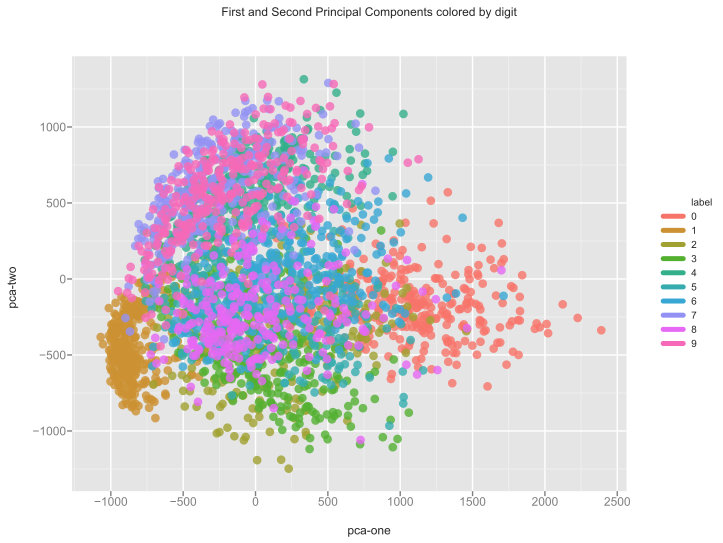

<ggplot: (200262480441)>

In [42]:





import ggplot
from ggplot import *

chart = ggplot( data.loc[rndperm[:3000],:], aes(x='pca-one', y='pca-two', color='label') ) \
        + geom_point(size=75,alpha=0.8) \
        + ggtitle("First and Second Principal Components colored by digit")
chart

In [166]:
feat_cols = [ 'pixel'+str(i) for i in range(X.shape[1]) ]

df = pd.DataFrame(X,columns=feat_cols)
df['label'] = y
df['label'] = df['label'].apply(lambda i: str(i))

X, y = None, None

print ('Size of the dataframe:' + format(df.shape))

Size of the dataframe:(70000, 785)


In [168]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
pca_result = pca.fit_transform(df[feat_cols].values)

df['pca-one'] = pca_result[:,0]
df['pca-two'] = pca_result[:,1] 
df['pca-three'] = pca_result[:,2]

print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))



Explained variation per principal component: [0.09746116 0.07155445 0.06149531]


In [161]:
import matplotlib
y = df['label']
df['label'] = df['label']
df.label.apply(lambda i: str(i))
y = df.label.unique()

In [173]:
df.label

0        0.0
1        0.0
2        0.0
3        0.0
4        0.0
5        0.0
6        0.0
7        0.0
8        0.0
9        0.0
10       0.0
11       0.0
12       0.0
13       0.0
14       0.0
15       0.0
16       0.0
17       0.0
18       0.0
19       0.0
20       0.0
21       0.0
22       0.0
23       0.0
24       0.0
25       0.0
26       0.0
27       0.0
28       0.0
29       0.0
        ... 
69970    9.0
69971    9.0
69972    9.0
69973    9.0
69974    9.0
69975    9.0
69976    9.0
69977    9.0
69978    9.0
69979    9.0
69980    9.0
69981    9.0
69982    9.0
69983    9.0
69984    9.0
69985    9.0
69986    9.0
69987    9.0
69988    9.0
69989    9.0
69990    9.0
69991    9.0
69992    9.0
69993    9.0
69994    9.0
69995    9.0
69996    9.0
69997    9.0
69998    9.0
69999    9.0
Name: label, Length: 70000, dtype: object